# Momentum: MACD Spread
***
2023-02-21. 

## Summary

We test a systematic strategy based on a spread variation of the Moving Average Convergence / Divergence (MACD) indicators on a BTC/USD portfolio.  

Given this is not yet backtested, analysis here are **descriptive only**.

**Hypothesis:** Rebalancing portfolio on MACD spread on tiered overbought/oversold signals performs better on a risk-adjusted basis than holding BTC over certain periods.

**Parameters:**
- Date: 2011-02-10 to 2023-02-09
- Frequency: daily
- No additional buy in after Time 0
- No trading fees
- No shorting

**Findings:**
- Overall, MACD spread portfolio results in lower annualized Sharpe Ratio generally (excl. rf, both simple and log returns) than holding
- In few cases, portfolio outperforms holding in non-annualized and annualized Sharpe Ratio
- 

**Discussion -> Next Steps:**
- Strategy missed ~first half of 2017 bull run -> perhaps overtuned to avoid bear runs, alternatives: adjust tiers, buy cheap puts while holding
- Need to backtest over out-of-time training / testing data
- Feedback: try for out of universe as well

## 1. Data
***

### 1.1. Import

Market Data as of: 2023-02-10  
BTC price data: Coin Metrics 'ReferenceRateUSD'  
SPY price data: WSJ Market Data  

In [1]:
##### Import Libraries
import glob 
import numpy as np
import pandas as pd
from statsmodels.graphics.gofplots import qqplot
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio
pio.renderers.default = "plotly_mimetype+notebook_connected"

In [2]:
##### Import Tokens

# Check number of coins
all_tokens = glob.glob('data/tokens/*.csv')

# Create dictionary of coin market data
coins_dict = dict()
for token in all_tokens:
    coin_name = token.split('/')[-1].split('.')[0]
    coins_dict[coin_name] = pd.read_csv(token, usecols=lambda x: x in ['time','ReferenceRateUSD', 'CapMrktCurUSD', 'CapMrktEstUSD'], parse_dates=['time'])
    
# Delete coins without at least price
coin_del = []
for coin in coins_dict.keys():
    if not {'ReferenceRateUSD'} <= set(coins_dict[coin].columns):
        coin_del.append(coin)

for coin in coin_del:
    coins_dict.pop(coin, None)

# Change current / estimated to just market cap, change reference rates to price
for coin in coins_dict.keys():
    if {'ReferenceRateUSD','CapMrktCurUSD'} <= set(coins_dict[coin].columns):
        coins_dict[coin] = coins_dict[coin].rename(columns={'ReferenceRateUSD':'price','CapMrktCurUSD':'cap'})
    elif {'ReferenceRateUSD','CapMrktEstUSD'} <= set(coins_dict[coin].columns):
        coins_dict[coin] = coins_dict[coin].rename(columns={'ReferenceRateUSD':'price','CapMrktEstUSD':'cap'})

# Create DataFrame of coin prices
coin_price = coins_dict['btc'].rename(columns={'price':'btc'})[['time','btc']]

coin_price.set_index('time',inplace=True)

for coin in coins_dict.keys():
    if not coin == 'btc':
        try:
            to_concat = coins_dict[coin].rename(columns={'price':coin})[['time',coin]]
            to_concat.set_index('time',inplace=True)
            coin_price = pd.concat([coin_price, to_concat],axis=1,join='outer')
        except KeyError:
            pass

coin_price = coin_price.fillna(method='ffill').fillna(0)

# print(f'number of coins total: {len(all_tokens)}')
# print(f'number of coins with price data: {len(coin_price.columns)}')

In [3]:
display(coin_price[['btc']])
display(coin_price[['btc']].describe())

,btc
time,
2009-01-03,0.000000
2009-01-04,0.000000
2009-01-05,0.000000
2009-01-06,0.000000
2009-01-07,0.000000
...,...
2023-02-05,23355.524386
2023-02-06,22957.225191
2023-02-07,22745.165037


,btc
count,5151.000000
mean,7756.203500
std,13940.029711
min,0.000000
25%,11.052683
50%,589.373502
75%,8795.111442
max,67541.755508


In [4]:
##### Import SPY

##Note, WSJ data column headers have an empty space in front, good one

# Check number of indexes
all_indexes = glob.glob('data/equities-indexes/*.csv')

index_dict = dict()
for index in all_indexes:
    index_name = index.split('/')[-1].split('.')[0]
    index_dict[index_name] = pd.read_csv(index, parse_dates=['Date'])
    
index_dict['spy'] = index_dict['spy'].sort_values(by='Date')
index_dict['spy'].set_index(['Date'], inplace=True)

# print(f'number of indexes total: {len(all_indexes)}')

In [5]:
display(index_dict['spy'])
display(index_dict['spy'].describe())

,Open,High,Low,Close,Volume
Date,,,,,
2010-12-29,125.98,126.20,125.9000,125.92,58033039
2010-12-30,125.80,126.13,125.5300,125.72,76616852
2010-12-31,125.53,125.87,125.3300,125.75,91270273
2011-01-03,126.71,127.60,125.6969,127.05,138725203
2011-01-04,127.33,127.37,126.1900,126.98,137409703
...,...,...,...,...,...
2023-02-03,411.59,416.97,411.0900,412.35,94736781
2023-02-06,409.79,411.29,408.1000,409.83,60295328
2023-02-07,408.87,416.49,407.5700,415.19,90990750


,Open,High,Low,Close,Volume
count,3050.000000,3050.000000,3050.000000,3050.000000,3.050000e+03
mean,251.600702,253.000111,250.076330,251.637781,1.104180e+08
std,95.916431,96.577802,95.175804,95.917162,6.411999e+07
min,108.350000,112.580000,107.430000,109.930000,2.027001e+07
25%,181.357500,182.102250,180.807500,181.591250,6.824341e+07
50%,226.875000,227.780000,226.140000,227.075000,9.334451e+07
75%,303.460000,306.201250,300.665000,303.322500,1.340440e+08
max,479.220000,479.980000,476.060000,477.710000,7.178286e+08


### 1.2. Analysis

We observe that BTC historical price movement is exponential relative to the SPY. Logging BTC price is warranted. 

BTC's 1yr trailing correlation with SPY is around 0.15. It is higher under 90d trailing and 30d trailing, reaching at peaks around 0.38 and 0.6 historically. 

We see from the histogram and more clearly QQ plot that historical BTC returns distribution is far less normally distributed compared to SPY with long tail returns.

High volatility and exponential price movement make moving averages, and momentum strategies in general, less applicable to BTC due to their reliance on smoothing over historical trailing periods. Further, annualizing Sharpe ratio from daily returns is less applicable due to particularly evident violation of IID. Preliminary analysis suggests momentum might not outperform holding despite likely lower volatility due to missing exponential gains from compression.

In [6]:
##### Define Plots

# Figure 0: Price ------------------------------------------------

def plot_coin_spy_price(coin, start_date, end_date):
    fig = make_subplots(
        rows=1, cols=2, 
        subplot_titles=('Price','Log Price'),
        specs=[[{"secondary_y": True},{"secondary_y": True}]]
    )
    fig.add_trace(
        go.Scatter(
            x=coin_price[coin].loc[start_date:end_date].index,
            y=coin_price[coin].loc[start_date:end_date],
            name=coin,
        ),
        row=1,
        col=1,
        secondary_y=False,
    )
    fig.add_trace(
        go.Scatter(
            x=index_dict['spy'].loc[start_date:end_date].index,
            y=index_dict['spy'].loc[start_date:end_date][' Close'],
            name='spy'
        ),
        row=1,
        col=1,
        secondary_y=True,

    )
    fig.add_trace(
        go.Scatter(
            x=coin_price[coin].loc[start_date:end_date].index,
            y=coin_price[coin].loc[start_date:end_date],
            name=f'ln({coin})',
        ),
        row=1,
        col=2,
        secondary_y=False,
    )
    fig.add_trace(
        go.Scatter(
            x=index_dict['spy'].loc[start_date:end_date].index,
            y=index_dict['spy'].loc[start_date:end_date][' Close'],
            name='ln(spy)'
        ),
        row=1,
        col=2,
        secondary_y=True,
    )
    
    fig['layout']['yaxis'].update(title_text='BTC')
    fig['layout']['yaxis2'].update(title_text='SPY')
    fig['layout']['yaxis3'].update(title_text='BTC')
    fig['layout']['yaxis3'].update(type='log')
    fig['layout']['yaxis4'].update(title_text='SPY')
    fig['layout']['yaxis4'].update(type='log')
    # fig.layout.annotations[1].update(text="Stackoverflow")
    
    fig.update_layout(
        autosize=True,
        # width=800,
        height=600,
    )    
    return fig

# Figure 2 : Correlations Plot Returns
def plot_returns_correlation(coin, start_date, end_date, trailing):
    df = pd.concat([index_dict['spy'].loc[start_date:end_date][' Close'].pct_change(), coin_price[coin].loc[start_date:end_date].pct_change()], join="outer", axis=1)
    
    df = df.fillna(method='ffill').fillna(method='bfill')
    
    df = df.rename(columns={' Close': 'spy'})
    
    dfcorr = df[coin].rolling(trailing).corr(df['spy'])
    dfcorr365 = df[coin].rolling('365d').corr(df['spy'])

    fig = go.Figure()
    fig.add_trace(
        go.Scatter(
            x=dfcorr.index,
            y=dfcorr,
            name=f'{trailing} corr',
        )
    )
    fig.add_trace(
        go.Scatter(
            x=dfcorr365.index,
            y=dfcorr365,
            name=f'365d corr',
        )
    )
    fig.update_layout(
        title={
            'text': f'{coin} + spy Returns Correlation',
        },
    )
    fig.update_layout(
        autosize=True,
        # width=800,
        height=600,
    )    
    return fig

In [7]:
%%capture
qqplot_btc = qqplot(coin_price[coin].pct_change(), line='s').gca().lines;
qqplot_spy = qqplot(index_dict['spy'][' Close'].pct_change(), line='s').gca().lines;

In [8]:
# Figure 3 : Returns Histogram
def plot_returns_distribution(coin, start_date, end_date):
    # fig = go.Figure()
    fig = make_subplots(
        rows=1, cols=2, 
        subplot_titles=('Histogram','QQ Plot'),
        # specs=[[{"secondary_y": True},{"secondary_y": True}]]
    )
    fig.add_trace(
        go.Histogram(
            x=coin_price[coin].loc[start_date:end_date].pct_change(),
            histnorm='probability',
            # cumulative_enabled=True,
            name=f'{coin}',
            # nbinsx = 125
        ),
        row=1,
        col=1
    )
    fig.add_trace(
        go.Histogram(
            x=index_dict['spy'].loc[start_date:end_date][' Close'].pct_change(),
            histnorm='probability',
            # cumulative_enabled=True,
            name='spy',
            # nbinsx = 125
        ),
        row=1,
        col=1,
    )
    fig.add_trace(
        go.Scatter(
            x= qqplot_btc[0].get_xdata(),
            y= qqplot_btc[0].get_ydata(),
            mode = 'markers',
            name = f'{coin} qq'
        ),
        row=1,
        col=2
    )
    fig.add_trace(
        go.Scatter(
            x= qqplot_spy[0].get_xdata(),
            y= qqplot_spy[0].get_ydata(),
            mode = 'markers',
            name = 'spy qq'
        ),
        row=1,
        col=2
    )
    fig.update_layout(
        autosize=True,
        # width=800,
        height=600,
    )    
    
    return fig

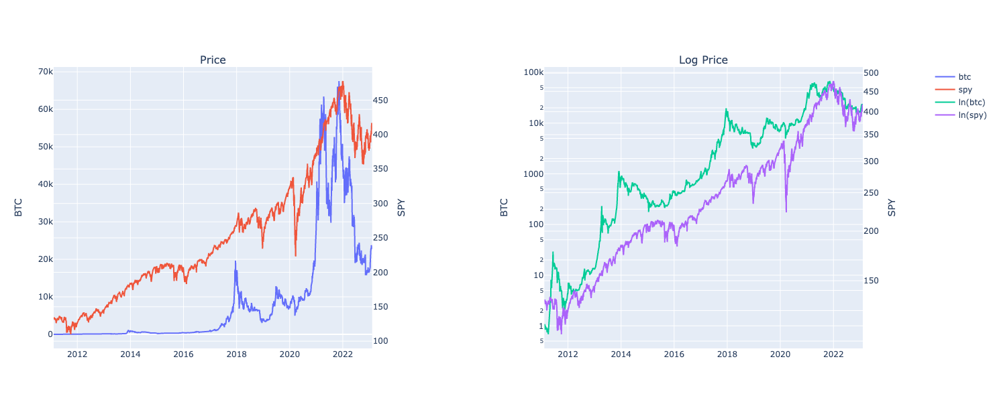

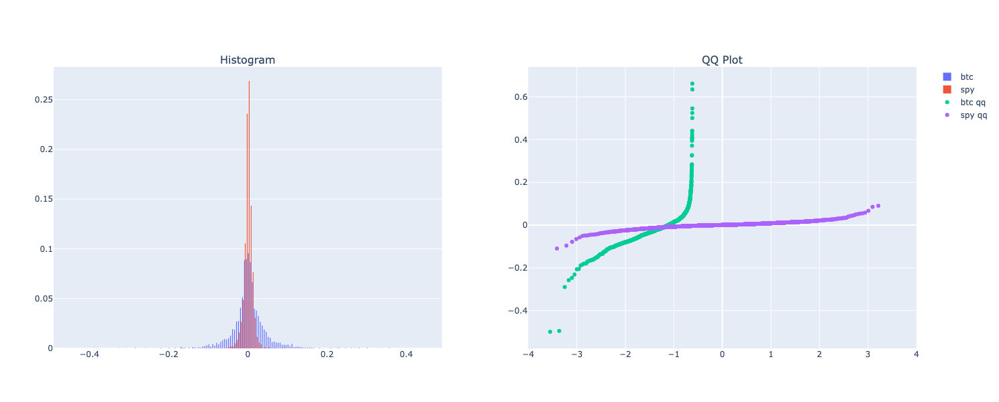

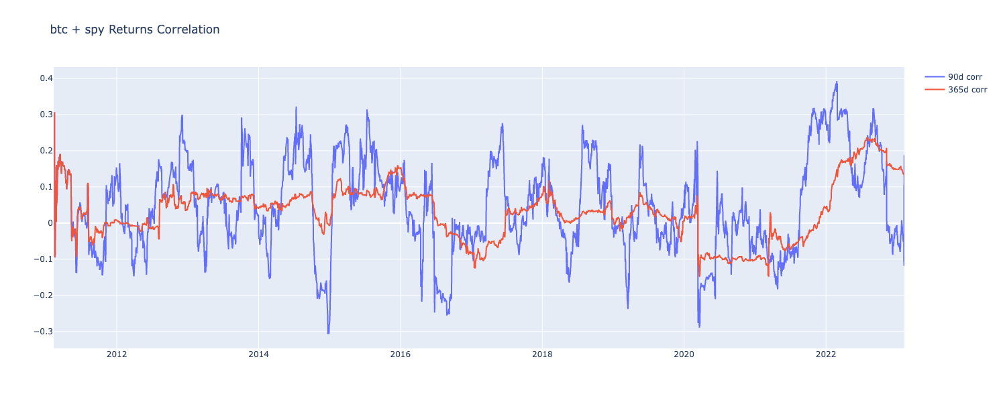

In [9]:
##### Draw Plots
coin = 'btc'
start_date = '2011-2-10'
end_date = '2023-02-09'
trailing = '90d'

plot_coin_spy_price(coin, start_date, end_date).show()
plot_returns_distribution(coin, start_date, end_date).show()
plot_returns_correlation(coin, start_date, end_date, trailing).show()

## 2. Create Signals
***

### 2.1. Define Variables

The standard MACD Logic is as follows:  
- MACD line = 12d price EMA - 26d price EMA
- Signal line = 9d MACD EMA
- Long: MACD line - Signal line > 0 (cross over)
- Short/sell: MACD line - signal line < 0 (cross under)

We make the following adjustments:
- Use SMA instead of EMA (compromise on time)
- MACD spread = 26d overbought/oversold SMA z scores
- Long: MACD spread < z score threshold (oversold) based on tiers
- Sell: MACD spread > z score threshold (overbought) based on tiers
- When overbought, do not buy until oversold (see tier table below)
- At Time = 0, hold Portfolio at 100% USD until oversold then buy into BTC accordingly



| Z score example    | Min | Max | BTC  | USD  |
|--------------------|-----|-----|------|------|
| Extreme Overbought | 3   | N/A | 0.05 | 0.95 |
| Overbought         | 2   | 3   | 0.2  | 0.8  |
| Slight Overbought  | 1   | 2   | 0.35 | 0.65 |
| Neutral            | -1  | 1   | 0.5  | 0.5  |
| Slight Oversold    | -2  | -1  | 0.65 | 0.35 |
| Oversold           | -3  | -2  | 0.8  | 0.2  |
| Extreme Oversold   | N/A | -3  | 0.95 | 0.05 |



In [10]:
macd1ma = 12
macd2ma = 26
signalma = 9
coin = 'btc'
start_date = '2011-2-10'
end_date = '2023-02-09'
trailing = '26d'

#36, 24, 18, 12, 6, 3

# not used
# rolling = 5
# obthreshold = 2
# osthreshold = -2

In [11]:
def macd_sma(coin, macd1ma, macd2ma, signalma, start_date, end_date):
    sma12 = coin_price[coin].rolling(macd1ma).mean().fillna(0).loc[start_date:end_date]
    sma26 = coin_price[coin].rolling(macd2ma).mean().fillna(0).loc[start_date:end_date]
    macd_sma = sma12 - sma26
    return macd_sma

def macd_sma_signal(signalma):
    macd_sma_signal = macd_sma(coin, macd1ma, macd2ma, signalma, start_date, end_date).rolling(signalma).mean().fillna(0)   
    return macd_sma_signal

def macd_sma_cross():
    macd_sma_cross = macd_sma(coin, macd1ma, macd2ma, signalma, start_date, end_date) - macd_sma_signal(signalma)
    return macd_sma_cross
    
def cross_dates():
    cross_trigger = macd_sma_cross().shift(1)/macd_sma_cross()
    cross_dates = [pd.to_datetime(start_date)] + list(cross_trigger[cross_trigger<0].index) + [pd.to_datetime(end_date)]
    return cross_dates

def zscore_macd():
    z = (macd_sma_cross() - macd_sma_cross().rolling(trailing).mean())/macd_sma_cross().rolling(trailing).std()
    return z

### 2.2. Analysis

First we observe from the '26dma MACD spread btc' plot that MACD SMA spread is less volatile than BTC spread over the same period, resulting in less portfolio rebalancing. This is expected given MACD spread applies smoothing to BTC price three times: in creating MACD line (12dma - 26dma), in creating the signal line (9dma MACD line), and finally in the 26dma spread of the MACD/Signal difference. The result is likely lower risk than holding BTC.

Second we see that the MACD spread visibly diverges from the BTC spread. Although lower risk, the risk-adjusted returns might underperform if the portfolio returns fail to make up the difference.

In [12]:
# Figure 1: MACD SMA Coin ------------------------------------------------

def plot_macd_sma(coin, macd1ma, macd2ma, signalma, start_date, end_date):
    fig = make_subplots(specs=[[{"secondary_y": True}]])

    macd_sma_over = macd_sma_cross()[macd_sma_cross()>0]
    macd_sma_under = macd_sma_cross()[macd_sma_cross()<0]
    
    # fig = go.Figure()
    fig.add_trace(
        go.Scatter(
            x=coin_price[coin].loc[start_date:end_date].index,
            y=coin_price[coin].loc[start_date:end_date],
            name=f'{coin} price',
            line=dict(width=1),
            opacity=0.9,
        ),
        secondary_y=True,
        
    )
    fig.add_trace(
        go.Bar(
            x=macd_sma_under.loc[start_date:end_date].index,
            y=macd_sma_under.loc[start_date:end_date],
            name=f'{coin} MACD SMA under',
        ),
        secondary_y=False,

    )
    fig.add_trace(
        go.Bar(
            x=macd_sma_over.loc[start_date:end_date].index,
            y=macd_sma_over.loc[start_date:end_date],
            name=f'{coin} MACD SMA over',
        ),
        secondary_y=False,

    )
    fig.add_trace(
        go.Scatter(
            x=macd_sma(coin, macd1ma, macd2ma, signalma, start_date, end_date).loc[start_date:end_date].index,
            y=macd_sma(coin, macd1ma, macd2ma, signalma, start_date, end_date).loc[start_date:end_date],
            name=f'{coin} MACD SMA 12d/26d',
        ),
        secondary_y=False,
    )
    fig.add_trace(
        go.Scatter(
            x=macd_sma_signal(signalma).loc[start_date:end_date].index,
            y=macd_sma_signal(signalma).loc[start_date:end_date],
            name=f'{coin} MACD SMA signal',
        ),
        secondary_y=False,

    )
    fig.update_layout(
        title={
            'text':f'{coin} MACD SMA {macd1ma}d/{macd2ma}d cross {signalma}d signal - {start_date} to {end_date}',
        },
    )  
    fig.update_layout(
        autosize=True,
        # width=800,
        height=600,
    )  
    return fig

In [13]:
# Figure 2 spread z score ------------------------------------------------

def plot_spread_macd_sma_zscore(coin, trailing, start_date, end_date):
    
    price_coin = coin_price[coin].loc[start_date:end_date]
    zscore_coin = (price_coin - price_coin.rolling(trailing).mean())/price_coin.rolling(trailing).std()
    
    # price_index = index_dict['spy'].loc[start_date:end_date][' Open']
    # zscore_index = (price_index - price_index.rolling(trailing).mean())/price_index.rolling(trailing).std()
    
    fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig.add_trace(
        go.Scatter(
            x=macd_sma_cross().loc[start_date:end_date].index,
            y=zscore_macd().loc[start_date:end_date],
            name=f'{trailing}ma MACD {coin}'
        ),
        secondary_y=False,
    )
    fig.add_trace(
        go.Scatter(
            x=coin_price[coin].loc[start_date:end_date].index,
            y=zscore_coin.loc[start_date:end_date],
            name=f'{trailing}ma {coin}',
            line=dict(width=1),
            # opacity=0.5,
        ),
        secondary_y=False,
    )
    # fig.add_trace(
    #     go.Scatter(
    #         x=index_dict['spy'].loc[start_date:end_date].index,
    #         y=zscore_index.loc[start_date:end_date],
    #         name=f'{trailing}ma spy',
    #         opacity=0.75,
    #         # line=dict(width=1),
    #     ),
    #     secondary_y=True,
    # )
    fig.add_shape(type='rect',
                  x0=start_date,
                  y0=1,
                  x1=end_date,
                  y1=2,
                  line=dict(color='Red'),
                  fillcolor='red',
                  opacity=0.1,)
    fig.add_shape(type='rect',
                  x0=start_date,
                  y0=2,
                  x1=end_date,
                  y1=4,
                  line=dict(color='Red'),
                  fillcolor='red',
                  opacity=0.25,)
    fig.add_shape(type='rect',
                  x0=start_date,
                  y0=-1,
                  x1=end_date,
                  y1=-2,
                  line=dict(color='green'),
                  fillcolor='green',
                  opacity=0.1,)
    fig.add_shape(type='rect',
                  x0=start_date,
                  y0=-2,
                  x1=end_date,
                  y1=-4,
                  line=dict(color='green'),
                  fillcolor='green',
                  opacity=0.25,)
    fig.update_yaxes(
        range = [
            -4,4
            
        ]
    )
    # fig.update_traces(
    #     # overwrite=True,
    #     visible='legendonly',
    #     selector=lambda t: not t.name in [f'{trailing}ma MACD {coin}'],
    # )
    fig.update_layout(
        title={
            'text': f'{trailing}ma MACD spread {coin} - {start_date} to {end_date}',
        },
    )
    fig.update_layout(
        autosize=True,
        # width=800,
        height=600,
    )  
    return fig

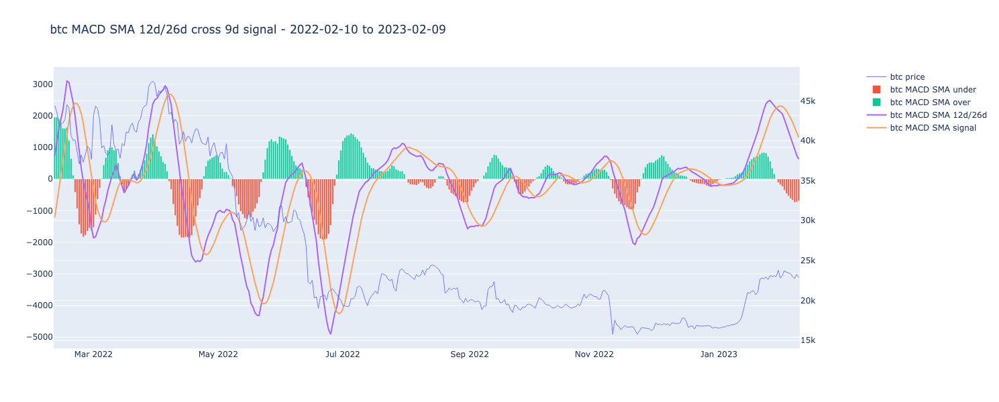

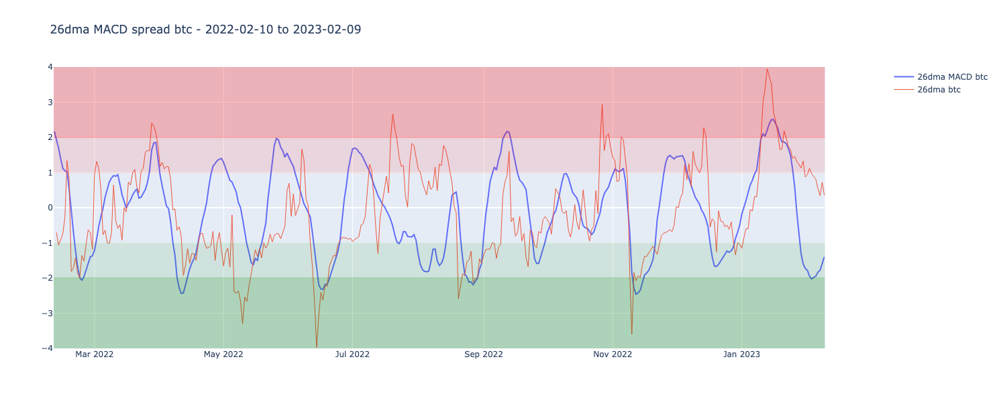

In [14]:
start = '2022-02-10'
end = '2023-02-09'
plot_macd_sma(coin, macd1ma, macd2ma, signalma, start, end).show()
# plot_macd_sma_spread(coin, macd1ma, macd2ma, signalma, start, end).show()
plot_spread_macd_sma_zscore(coin, trailing, start, end).show()

## 3. Run Strategy
***

### 3.1. Portfolio Rebalancing 

The rebalancing is calculated as follows: the signal at the end of previous day informs next day's portfolio distribution. For example, hypothetically at the end of 01-31-2021, we have a Z score of -2.5. The portfolio distributes 80% of current value to BTC, 20% to USD. On 02-01-2021, 80% of portfolio value from 01-31-2021 is subjected to 02-01-2021's BTC return for the day.

Calculations:  
$V_T$ = portfolio value at time T  
$P_T$ = proportion of BTC in the portfolio  
$R_T$ = BTC daily simple returns  


$$V_T = V_{T-1} * P_{T-1} * R_T$$

In [15]:
# placeholder for backtesting later
portfolio_start_date = start_date
portfolio_end_date = end_date
portfolio_initial_value = 100

In [16]:
# clean this up
def macd_tiered_rebal(coin, start_date, end_date):
    zdf = pd.DataFrame(zscore_macd(),index=zscore_macd().index).rename(columns={'btc':'zscore'})
    zdf = pd.concat([zdf, coin_price[coin].pct_change().loc[start_date:end_date]],axis=1, join='inner')
    zdf = zdf.rename(columns={'btc':'btc_ret'})
    zdf = zdf.fillna(0)

    btc_rebal = []
    for zscore in zdf['zscore']:
        if zscore >= 3:
            btc_rebal.append(0.05)
        elif zscore >= 2 and zscore < 3:
            btc_rebal.append(0.2)
        elif zscore >= 1 and zscore < 2:
            btc_rebal.append(0.35)
        elif zscore >= -1 and zscore < 1:
            btc_rebal.append(0.5)
        elif zscore >= -2 and zscore < -1:
            btc_rebal.append(0.65)
        elif zscore >= -3 and zscore < -2:
            btc_rebal.append(0.8)
        elif zscore < -3:
            btc_rebal.append(0.95)

    btc_rebal_df = pd.DataFrame(btc_rebal, index=zdf.index, columns=['btc_rebal_next'])
    zdf = pd.concat([zdf,btc_rebal_df], axis=1, join='inner')
    zdf['usd_rebal_next'] = 1 - zdf['btc_rebal_next']    

    obosdf = pd.concat([zdf[zdf['btc_rebal_next'] == zdf['btc_rebal_next'].min()], zdf[zdf['btc_rebal_next'] == zdf['btc_rebal_next'].max()]],axis=0).sort_values(by='time')

    obosdf['signal_forward'] = obosdf['btc_rebal_next'].pct_change().fillna(0)
    obosdf['signal_reverse'] = obosdf['btc_rebal_next'].pct_change(1).shift(-1).fillna(0)
    obosdf['signal'] = obosdf['signal_forward'] + obosdf['signal_reverse']
    
    obosdf2 = obosdf[obosdf['signal']>0]
    
    if obosdf2['btc_rebal_next'][0] == obosdf2['btc_rebal_next'][0].min():
        i = 0
        while i < len(obosdf2):
            zdf['btc_rebal_next'].loc[obosdf2.index[i]+pd.Timedelta(1, unit='d'):obosdf2.index[i+1]-pd.Timedelta(1, unit='d')] = obosdf2['btc_rebal_next'][0].min()
            zdf['usd_rebal_next'].loc[obosdf2.index[i]+pd.Timedelta(1, unit='d'):obosdf2.index[i+1]-pd.Timedelta(1, unit='d')] = 1 - obosdf2['btc_rebal_next'][0].min()
            i += 2
    else:
        i = 0
        while i < len(obosdf2):
            zdf['btc_rebal_next'].loc[obosdf2.index[i+1]+pd.Timedelta(1, unit='d'):obosdf2.index[i+2]-pd.Timedelta(1, unit='d')] = obosdf2['btc_rebal_next'][0].min()
            zdf['usd_rebal_next'].loc[obosdf2.index[i+1]+pd.Timedelta(1, unit='d'):obosdf2.index[i+2]-pd.Timedelta(1, unit='d')] = 1 - obosdf2['btc_rebal_next'][0].min()
            i += 2
        
    return zdf

zdf = macd_tiered_rebal(coin, start_date, end_date)

In [17]:
def macd_tiered_strategy_run(portfolio_start_date, portfolio_end_date, portfolio_initial_value):
    
    zdf['port_ret'] = zdf['btc_rebal_next'].shift(1) * zdf['btc_ret']

    buyin_date = zdf[zdf['zscore']<=-1].loc[portfolio_start_date:portfolio_end_date].index[0]
    
    zdf2 = zdf.loc[buyin_date:].copy()
    
    port_value = portfolio_initial_value
    hold_value = portfolio_initial_value
    port_bal = [port_value]
    hold_bal = [hold_value]
    
    for i in range(0, len(zdf2.index)-1):
        
        port_value = port_value * (1+zdf2['port_ret'][i+1])
        port_bal.append(port_value)
        
        hold_value = hold_value * (1+zdf2['btc_ret'][i+1])
        hold_bal.append(hold_value)
    
    zdf2 = pd.concat([zdf2,pd.DataFrame(port_bal, index=zdf2.index, columns=['port_value']), pd.DataFrame(hold_bal, index=zdf2.index, columns=['hold_value'])],axis=1, join='inner')

    zdf2['usd_bal'] = (zdf2['port_value'] * zdf2['usd_rebal_next']).shift(1)
    zdf2['btc_bal'] = zdf2['port_value'] - zdf2['usd_bal']

    zdf2 = zdf2[['zscore',	'btc_rebal_next', 'usd_rebal_next',	'btc_ret', 'port_ret', 'hold_value', 'port_value',	'btc_bal',	'usd_bal']]
    
    return zdf2

zdf2 = macd_tiered_strategy_run(portfolio_start_date, portfolio_end_date, portfolio_initial_value)
# zdf3 = zdf2.copy()

### 3.2. Analysis

The strategy sells BTC to 5% during three major periods and holds it in 0.05/0.95 BTC/USD ratio:
1. 2011-Nov to 2012-Jan
2. 2016-Jun to 2017-Jul
3. 2020-Sep to 2020-Dec

During those periods, the graph shows the strategy could not take advantage of bull runs, in the particular the 2017 exponential bull run when price quadripled.

In [18]:
def plot_macd_sma_eqv_rebal(coin, start_date, end_date):
    
    fig = make_subplots(
        specs=[[{"secondary_y": True}]]
    )
    # fig = go.Figure()
    
    fig.add_trace(
        go.Scatter(
            x=zdf2.loc[start_date:end_date].index,
            y=zdf2.loc[start_date:end_date]['btc_rebal_next'],
            name=f'port {coin} pct',
            stackgroup='one'
        ),      
        secondary_y=False,
    )
    fig.add_trace(
        go.Scatter(
            x=zdf2.loc[start_date:end_date].index,
            y=zdf2.loc[start_date:end_date]['usd_rebal_next'],
            name=f'port usd pct',
            stackgroup='one'
        ),   
        secondary_y=False,
    )
    fig.add_trace(
        go.Scatter(
            x=coin_price[coin].loc[start_date:end_date].index,
            y=coin_price[coin].loc[start_date:end_date],
            name=f'btc price',
            # fill="tonexty"
            # stackgroup='one'
        ),
        secondary_y=True,
    )
    
    fig['layout']['yaxis1'].update(title_text='portfolio pct')
    fig['layout']['yaxis2'].update(title_text='log btc price')
    fig['layout']['yaxis2'].update(type='log')
    
    fig.update_layout(
        title={
            'text':'Portfolio Rebalancing',
        },
        autosize=True,
        # width=800,
        height=600,
    )  
    return fig

In [19]:
def plot_macd_sma_eqv_value(coin,start_date, end_date):
    # fig = make_subplots(
    #     rows=1, cols=2, 
    #     subplot_titles=('Price','Log Price'),
    #     specs=[[{"secondary_y": True},{"secondary_y": True}]]
    fig = make_subplots(
        specs=[[{"secondary_y": True}]]
    )
    fig.add_trace(
        go.Scatter(
            x=zdf2.loc[start_date:end_date].index,
            y=zdf2.loc[start_date:end_date]['btc_bal'],
            name=f'port {coin} value',
            # fill="tonexty"
            stackgroup='one'
        ),
        secondary_y=False,
    )
    fig.add_trace(
        go.Scatter(
            x=zdf2.loc[start_date:end_date].index,
            y=zdf2.loc[start_date:end_date]['usd_bal'],
            name=f'port usd value',
            # fill="tonexty"
            stackgroup='one'
        ),
        secondary_y=False,
    )
    fig.add_trace(
        go.Scatter(
            x=coin_price[coin].loc[start_date:end_date].index,
            y=coin_price[coin].loc[start_date:end_date],
            name=f'btc price',
            # fill="tonexty"
            # stackgroup='one'
        ),
        secondary_y=True,
    )
    fig['layout']['yaxis1'].update(title_text='portfolio value')
    fig['layout']['yaxis2'].update(title_text='log btc price')
    fig['layout']['yaxis2'].update(type='log')
    fig.update_layout(
        title={
            'text':'Portfolio Value',
        },
        autosize=True,
        # width=800,
        height=600,
    )  
    return fig

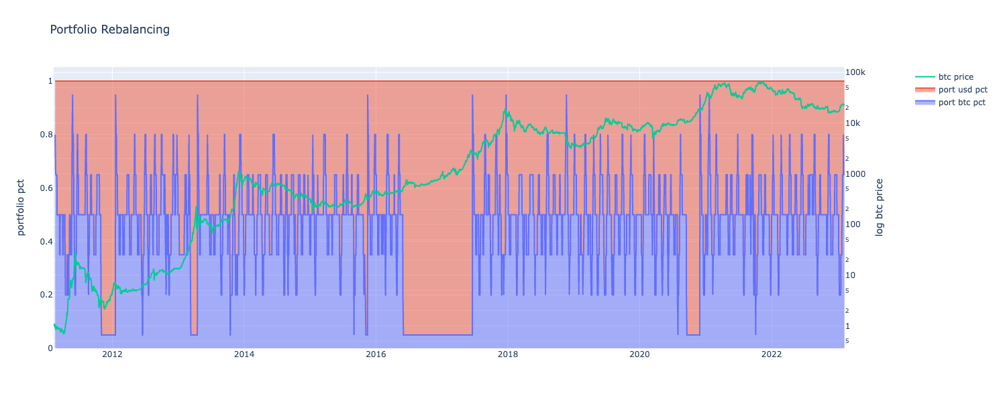

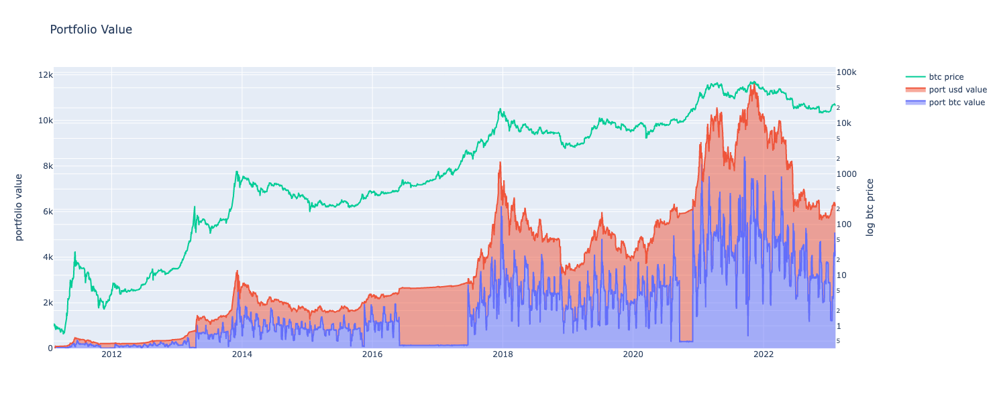

In [20]:
start = start_date
end = end_date
plot_macd_sma_eqv_rebal(coin, start, end).show()
plot_macd_sma_eqv_value(coin,start, end).show()

## 4. Performance Summary
***

### 4.1 Calculate Performance

We calculate the annualized Sharpe, Sortino, and Information ratio as follows:  


$$Sharpe =\sqrt365 \ * \frac{\bar{R_p} - R_f}{\sigma_p}$$

$$Sortino = \sqrt365 \ * \frac{\bar{R_p} - R_f}{\sigma_{downside \ risk}}$$

$$Information = \sqrt365 \ * \frac{\bar{R_p} - \bar{R_h}}{\sigma_{tracking \ error}}$$

Where:

$$\bar{R_p} = mean(ln(\frac{R_{p,n}}{R_{p,n-1}}))$$

$$\sigma_p = std(ln(\frac{R_{p,n}}{R_{p,n-1}}))$$

$$\sigma_{downside \ risk} = std(ln(\frac{R_{p,n}}{R_{p,n-1}} < 0))$$

$$\sigma_{tracking \ error} = std(ln(\frac{R_{p,n}}{R_{p,n-1}} - ln(\frac{R_{h,n}}{R_{h,n-1}}))$$

We use log returns instead of simple returns due averaging returns over multiple periods. Simple returns would have returned inflated ratios. We multiply by square root of 365 given our average mean returns is calculated on a daily basis, and BTC trades 24/7/.

In [21]:
# simple returns
zdf2['port_ret'] = zdf2['port_value'].pct_change()
zdf2['hold_ret'] = zdf2['hold_value'].pct_change()

# log returns
zdf2['port_ln_ret'] = np.log(zdf2['port_value']/zdf2['port_value'].shift(1))
zdf2['hold_ln_ret'] = np.log(zdf2['hold_value']/zdf2['hold_value'].shift(1))

# returns for sortino
zdf2 = pd.concat([zdf2, pd.DataFrame(zdf2[zdf2['port_ret']<0]['port_ret']).rename(columns={'port_ret':'port_ret_sortino'})], axis=1, join='outer')
zdf2 = pd.concat([zdf2, pd.DataFrame(zdf2[zdf2['hold_ret']<0]['hold_ret']).rename(columns={'hold_ret':'hold_ret_sortino'})], axis=1, join='outer')
zdf2 = pd.concat([zdf2, pd.DataFrame(zdf2[zdf2['port_ln_ret']<0]['port_ln_ret']).rename(columns={'port_ln_ret':'port_ln_ret_sortino'})], axis=1, join='outer')
zdf2 = pd.concat([zdf2, pd.DataFrame(zdf2[zdf2['hold_ln_ret']<0]['hold_ln_ret']).rename(columns={'hold_ln_ret':'hold_ln_ret_sortino'})], axis=1, join='outer')

In [22]:
trailing_days = [30,91,182,365,730,1095]

for days in trailing_days:
    
    zdf2[f'port_sharpe_{days}d'] = (zdf2['port_ret'].rolling(days).mean() / zdf2['port_ret'].rolling(days).std())*(365**0.5)
    zdf2[f'hold_sharpe_{days}d'] = (zdf2['hold_ret'].rolling(days).mean() / zdf2['hold_ret'].rolling(days).std())*(365**0.5)
    
    zdf2[f'port_sortino_{days}d'] = (zdf2['port_ret'].rolling(days).mean() / zdf2['port_ret_sortino'].rolling(days, min_periods=1).std())*(365**0.5)
    zdf2[f'hold_sortino_{days}d'] = (zdf2['hold_ret'].rolling(days).mean() / zdf2['hold_ret_sortino'].rolling(days, min_periods=1).std())*(365**0.5)
    
    zdf2[f'port_info_{days}d'] = ((zdf2['port_ret'].rolling(days).mean()-zdf2['hold_ret'].rolling(days).mean()) / (zdf2['port_ret']-zdf2['hold_ret']).rolling(days).std())*(365**0.5)
    zdf2[f'hold_info_{days}d'] = ((zdf2['hold_ret'].rolling(days).mean()-zdf2['port_ret'].rolling(days).mean()) / (zdf2['hold_ret']-zdf2['port_ret']).rolling(days).std())*(365**0.5)
    
    zdf2[f'port_ln_sharpe_{days}d'] = (zdf2['port_ln_ret'].rolling(days).mean() / zdf2['port_ln_ret'].rolling(days).std())*(365**0.5)
    zdf2[f'hold_ln_sharpe_{days}d'] = (zdf2['hold_ln_ret'].rolling(days).mean() / zdf2['hold_ln_ret'].rolling(days).std())*(365**0.5)
    
    zdf2[f'port_ln_sortino_{days}d'] = (zdf2['port_ln_ret'].rolling(days).mean() / zdf2['port_ln_ret_sortino'].rolling(days, min_periods=1).std())*(365**0.5)
    zdf2[f'hold_ln_sortino_{days}d'] = (zdf2['hold_ln_ret'].rolling(days).mean() / zdf2['hold_ln_ret_sortino'].rolling(days, min_periods=1).std())*(365**0.5)
    
    zdf2[f'port_ln_info_{days}d'] = ((zdf2['port_ln_ret'].rolling(days).mean()-zdf2['hold_ln_ret'].rolling(days).mean()) / (zdf2['port_ln_ret']-zdf2['hold_ln_ret']).rolling(days).std())*(365**0.5)
    zdf2[f'hold_ln_info_{days}d'] = ((zdf2['hold_ln_ret'].rolling(days).mean()-zdf2['port_ln_ret'].rolling(days).mean()) / (zdf2['hold_ln_ret']-zdf2['port_ln_ret']).rolling(days).std())*(365**0.5)
    

drop_columns = ['port_ret_sortino','hold_ret_sortino','port_ln_ret_sortino','hold_ln_ret_sortino']
zdf2 = zdf2.drop(columns=drop_columns)

In [23]:
ratio_dict = dict()

n = 12
i = 0
while n <= len(zdf2.iloc[:,12:].columns):
# ratio_dict[days] = zdf2.iloc[:,12:24]
    ratio_dict[trailing_days[i]] = zdf2.iloc[:,n:n+12]
    n += 12
    i += 1

### 4.2. Analysis

On an annualized basis, MACD SMA spread fails to outperform holding BTC in a risk-adjusted basis for all performance ratios across 1mo, 3mo, 6mo, 12mo, 24mo, and 36mo trailing periods. We see from the trailing returns and volatility plots that despite the portfolio halving volatility, it missed significant periods of high returns, which was likely a culprit for its underperformance.

This analysis is weak evidence against our hypothesis that MACD spreads beats holding BTC. Several factors mentioned at the start contributed to this performance, such as using SMA instead of EMA, and the difficulty of annualizing ratios. In fact, for the past 365 days, although MACD underperformed BTC, the actual results are:
- MACD ret: -34%
- BTC ret: -48%
- MACD vol: 0.02
- BTC vol: 0.04

On this non-annualized basis, MACD portfolio outperforms holding BTC. Next steps could be to give alternative performance indicators to capture these results.

##### Define Performance Table

In [24]:
# refactor this later
def display_performance_table_average():
    
    ratios = ['sharpe','sortino','info','ln_sharpe','ln_sortino','ln_info',]
    port_ratio = []
    hold_ratio = []
    values = [trailing_days]

    for ratio in ratios:
        p30 = '{0:.2f}'.format(ratio_dict[30][f'port_{ratio}_30d'].mean())
        p91 = '{0:.2f}'.format(ratio_dict[91][f'port_{ratio}_91d'].mean())
        p182 = '{0:.2f}'.format(ratio_dict[182][f'port_{ratio}_182d'].mean())
        p365 = '{0:.2f}'.format(ratio_dict[365][f'port_{ratio}_365d'].mean())
        p730 = '{0:.2f}'.format(ratio_dict[730][f'port_{ratio}_730d'].mean())
        p1095 = '{0:.2f}'.format(ratio_dict[1095][f'port_{ratio}_1095d'].mean())
        values.append([p30,p91,p182,p365,p730,p1095])
        h30 = '{0:.2f}'.format(ratio_dict[30][f'hold_{ratio}_30d'].mean())
        h91 = '{0:.2f}'.format(ratio_dict[91][f'hold_{ratio}_91d'].mean())
        h182 = '{0:.2f}'.format(ratio_dict[182][f'hold_{ratio}_182d'].mean())
        h365 = '{0:.2f}'.format(ratio_dict[365][f'hold_{ratio}_365d'].mean())
        h730 = '{0:.2f}'.format(ratio_dict[730][f'hold_{ratio}_730d'].mean())
        h1095 = '{0:.2f}'.format(ratio_dict[1095][f'hold_{ratio}_1095d'].mean())
        values.append([h30,h91,h182,h365,h730,h1095])    
         
 
    fig = go.Figure(
        go.Table(
            header=dict(
                values=[
                    ['<b>Annualized</b>','<b>Average</b>' ],
                    ['Portfolio','Sharpe'],
                    ['Hold','Sharpe'],
                    ['Portfolio','Sortino'],
                    ['Hold','Sortino'],
                    ['Portfolio','Info'],
                    ['Hold','Info'],
                    ['Portfolio','Sharpe (ln ret)'],
                    ['Hold','Sharpe (ln ret)'],
                    ['Portfolio','Sortino (ln ret)'],
                    ['Hold','Sortino (ln ret)'],
                    ['Portfolio','Info (ln ret)'],
                    ['Hold','Info (ln ret)'],
                ],
                align=['left','center'],  
            ),
            cells=dict(
                values=values,
                align = ['left', 'center'],
            )
        )        
    )
    fig.update_layout(
        title={
            'text':f'Performance Summary - Average from {start_date} to {end_date}',
        },
        # autosize=True,
        # # width=800,
        # height=600,
    )  
    return fig

#######################################################################################################
def display_performance_table_recent():
    
    ratios = ['sharpe','sortino','info','ln_sharpe','ln_sortino','ln_info',]
    port_ratio = []
    hold_ratio = []
    values = [trailing_days]
    # values_final = [trailing_days]


    for ratio in ratios:
        p30 = '{0:.2f}'.format(ratio_dict[30][f'port_{ratio}_30d'][-1])
        p91 = '{0:.2f}'.format(ratio_dict[91][f'port_{ratio}_91d'][-1])
        p182 = '{0:.2f}'.format(ratio_dict[182][f'port_{ratio}_182d'][-1])
        p365 = '{0:.2f}'.format(ratio_dict[365][f'port_{ratio}_365d'][-1])
        p730 = '{0:.2f}'.format(ratio_dict[730][f'port_{ratio}_730d'][-1])
        p1095 = '{0:.2f}'.format(ratio_dict[1095][f'port_{ratio}_1095d'][-1])
        values.append([p30,p91,p182,p365,p730,p1095])
        h30 = '{0:.2f}'.format(ratio_dict[30][f'hold_{ratio}_30d'][-1])
        h91 = '{0:.2f}'.format(ratio_dict[91][f'hold_{ratio}_91d'][-1])
        h182 = '{0:.2f}'.format(ratio_dict[182][f'hold_{ratio}_182d'][-1])
        h365 = '{0:.2f}'.format(ratio_dict[365][f'hold_{ratio}_365d'][-1])
        h730 = '{0:.2f}'.format(ratio_dict[730][f'hold_{ratio}_730d'][-1])
        h1095 = '{0:.2f}'.format(ratio_dict[1095][f'hold_{ratio}_1095d'][-1])
        values.append([h30,h91,h182,h365,h730,h1095])    
         
 
    fig = go.Figure(
        go.Table(
            header=dict(
                values=[
                    ['<b>Annualized</b>','<b>Last</b>' ],
                    ['Portfolio','Sharpe'],
                    ['Hold','Sharpe'],
                    ['Portfolio','Sortino'],
                    ['Hold','Sortino'],
                    ['Portfolio','Info'],
                    ['Hold','Info'],
                    ['Portfolio','Sharpe (ln ret)'],
                    ['Hold','Sharpe (ln ret)'],
                    ['Portfolio','Sortino (ln ret)'],
                    ['Hold','Sortino (ln ret)'],
                    ['Portfolio','Info (ln ret)'],
                    ['Hold','Info (ln ret)'],
                ],
                align=['left','center'],  
            ),
            cells=dict(
                values=values,
                align = ['left', 'center'],
            )
        )        
    )
    fig.update_layout(
        title={
            'text':f'Performance Summary - Trailing {end_date}',
        },
        # autosize=True,
        # # width=800,
        # height=600,
    )  
    return fig


##### Define Sharpe Ratio Plots

In [25]:
def plot_macd_trailing_sharpe_30(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_sharpe_30d'],
                name=f'{portfolio}_ln_sharpe_30d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 30d Portfolio vs BTC hodl Sharpe',
        },
    )  
    return fig

def plot_macd_trailing_sharpe_91(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_sharpe_91d'],
                name=f'{portfolio}_ln_sharpe_91d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 91d Portfolio vs BTC hodl Sharpe',
        },
    )  
    return fig

def plot_macd_trailing_sharpe_182(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_sharpe_182d'],
                name=f'{portfolio}_ln_sharpe_182d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 182d Portfolio vs BTC hodl Sharpe',
        },
    )  
    return fig

def plot_macd_trailing_sharpe_365(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_sharpe_365d'],
                name=f'{portfolio}_ln_sharpe_365d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 365d Portfolio vs BTC hodl Sharpe',
        },
    )  
    return fig


def plot_macd_trailing_sharpe_730(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_sharpe_730d'],
                name=f'{portfolio}_ln_sharpe_730d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 730d Portfolio vs BTC hodl Sharpe',
        },
    )  
    return fig

def plot_macd_trailing_sharpe_1095(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_sharpe_1095d'],
                name=f'{portfolio}_ln_sharpe_1095d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 1095d Portfolio vs BTC hodl Sharpe',
        },
    )  
    return fig


##### Define Sortino Ratio Plots

In [26]:
def plot_macd_trailing_sortino_30(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_sortino_30d'],
                name=f'{portfolio}_ln_sortino_30d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 30d Portfolio vs BTC hodl Sortino',
        },
    )  
    return fig

def plot_macd_trailing_sortino_91(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_sortino_91d'],
                name=f'{portfolio}_ln_sortino_91d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 91d Portfolio vs BTC hodl Sortino',
        },
    )  
    return fig

def plot_macd_trailing_sortino_182(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_sortino_182d'],
                name=f'{portfolio}_ln_sortino_182d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 182d Portfolio vs BTC hodl Sortino',
        },
    )  
    return fig

def plot_macd_trailing_sortino_365(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_sortino_365d'],
                name=f'{portfolio}_ln_sortino_365d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 365d Portfolio vs BTC hodl Sortino',
        },
    )  
    return fig


def plot_macd_trailing_sortino_730(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_sortino_730d'],
                name=f'{portfolio}_ln_sortino_730d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 730d Portfolio vs BTC hodl Sortino',
        },
    )  
    return fig

def plot_macd_trailing_sortino_1095(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_sortino_1095d'],
                name=f'{portfolio}_ln_sortino_1095d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 1095d Portfolio vs BTC hodl Sortino',
        },
    )  
    return fig


##### Define Information Ratio Plots

In [27]:
def plot_macd_trailing_info_30(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_info_30d'],
                name=f'{portfolio}_ln_info_30d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 30d Portfolio vs BTC hodl Information Ratio',
        },
    )  
    return fig

def plot_macd_trailing_info_91(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_info_91d'],
                name=f'{portfolio}_ln_info_91d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 91d Portfolio vs BTC hodl Information Ratio',
        },
    )  
    return fig

def plot_macd_trailing_info_182(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_info_182d'],
                name=f'{portfolio}_ln_info_182d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 182d Portfolio vs BTC hodl Information Ratio',
        },
    )  
    return fig

def plot_macd_trailing_info_365(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_info_365d'],
                name=f'{portfolio}_ln_info_365d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 365d Portfolio vs BTC hodl Information Ratio',
        },
    )  
    return fig


def plot_macd_trailing_info_730(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_info_730d'],
                name=f'{portfolio}_ln_info_730d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 730d Portfolio vs BTC hodl Information Ratio',
        },
    )  
    return fig

def plot_macd_trailing_info_1095(df, start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=df.loc[start:end].index,
                y=df.loc[start:end][f'{portfolio}_ln_info_1095d'],
                name=f'{portfolio}_ln_info_1095d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 1095d Portfolio vs BTC hodl Information Ratio',
        },
    )  
    return fig


In [28]:
def plot_macd_trailing_ret_365(start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=zdf2.loc[start:end].index,
                y=zdf2[f'{portfolio}_ret'].rolling(365).mean().loc[start:end],
                name=f'{portfolio}_ret_365d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 365d Portfolio vs BTC hodl rolling 365d ret',
        },
    )  
    return fig

def plot_macd_trailing_vol_365(start, end):
    # fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()
    for portfolio in ['port','hold']:
        fig.add_trace(
            go.Scatter(
                x=zdf2.loc[start:end].index,
                y=zdf2[f'{portfolio}_ret'].rolling(365).std().loc[start:end],
                name=f'{portfolio}_vol_365d'
            )
        )
    fig.update_layout(
        title={
            'text':f'{start} to {end} 365d Portfolio vs BTC hodl rolling 365d vol',
        },
    )  
    return fig

##### Draw Plots

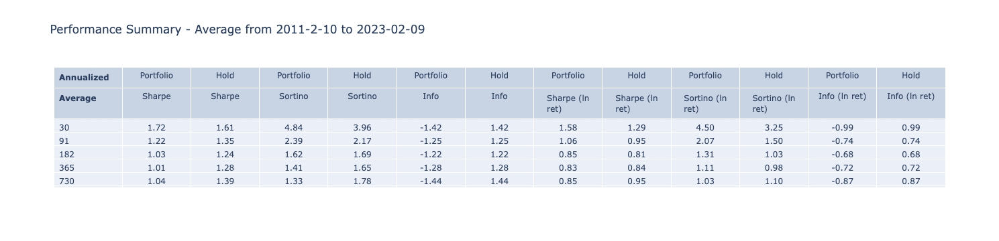

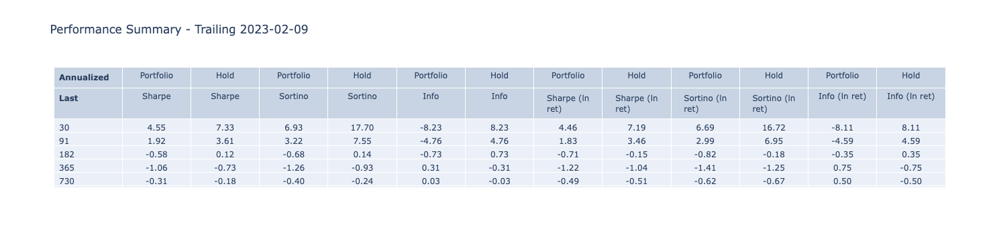

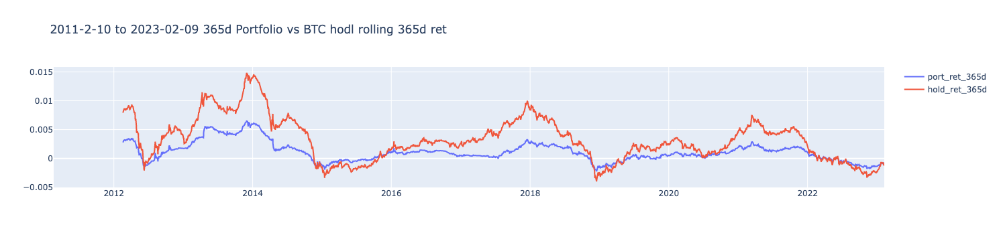

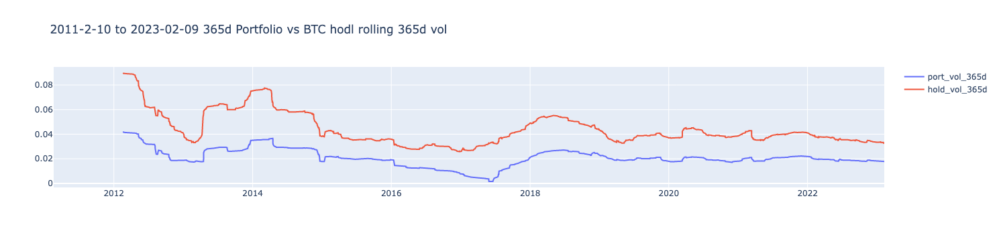

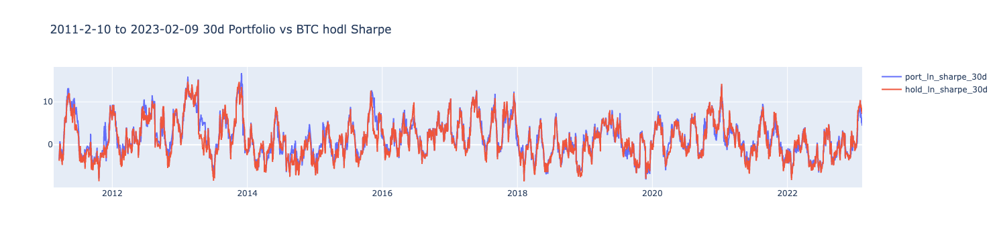

...

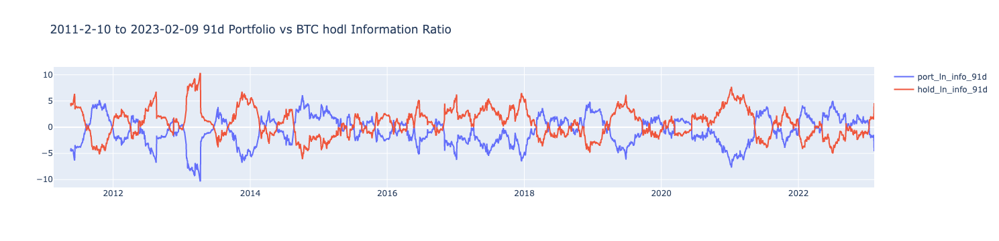

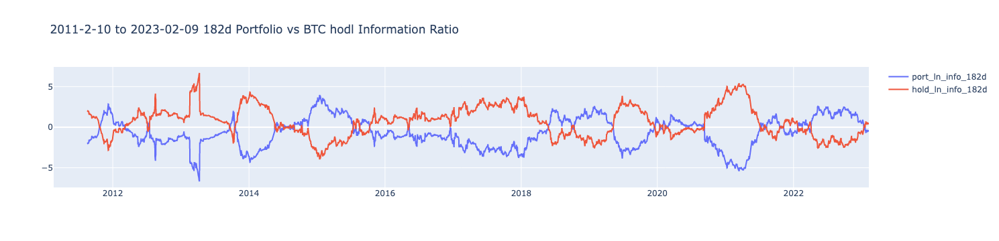

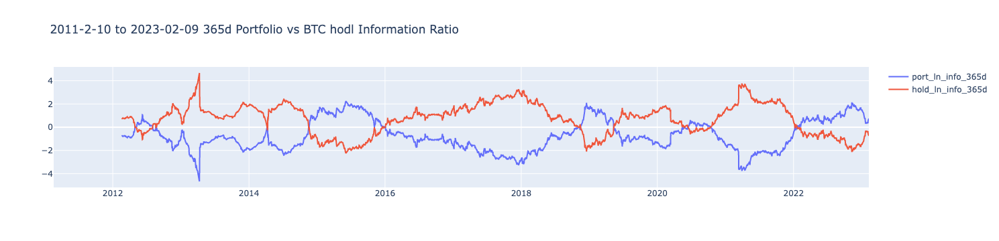

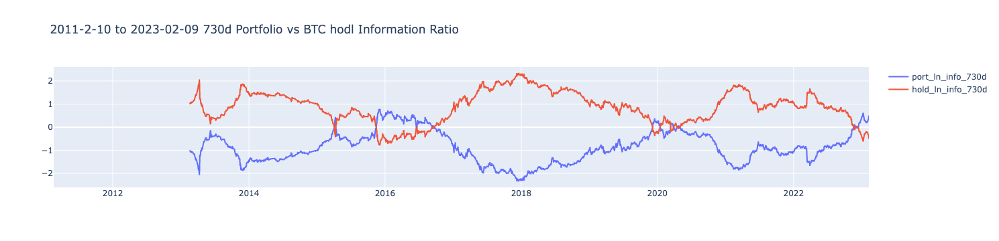

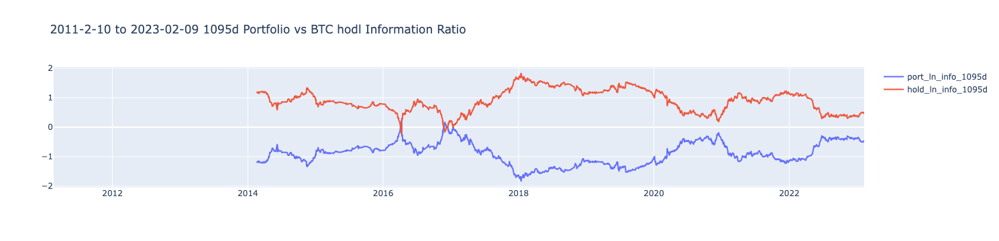

In [29]:
display_performance_table_average().show()
display_performance_table_recent().show()

plot_macd_trailing_ret_365(start, end).show()
plot_macd_trailing_vol_365(start, end).show()

plot_macd_trailing_sharpe_30(zdf2, start,end).show()
plot_macd_trailing_sharpe_91(zdf2, start,end).show()
plot_macd_trailing_sharpe_182(zdf2, start,end).show()
plot_macd_trailing_sharpe_365(zdf2, start,end).show()
plot_macd_trailing_sharpe_730(zdf2, start,end).show()
plot_macd_trailing_sharpe_1095(zdf2, start,end).show()

plot_macd_trailing_sortino_30(zdf2, start,end).show()
plot_macd_trailing_sortino_91(zdf2, start,end).show()
plot_macd_trailing_sortino_182(zdf2, start,end).show()
plot_macd_trailing_sortino_365(zdf2, start,end).show()
plot_macd_trailing_sortino_730(zdf2, start,end).show()
plot_macd_trailing_sortino_1095(zdf2, start,end).show()

plot_macd_trailing_info_30(zdf2, start,end).show()
plot_macd_trailing_info_91(zdf2, start,end).show()
plot_macd_trailing_info_182(zdf2, start,end).show()
plot_macd_trailing_info_365(zdf2, start,end).show()
plot_macd_trailing_info_730(zdf2, start,end).show()
plot_macd_trailing_info_1095(zdf2, start,end).show()


# plot_macd_trailing_infor_30(start,end).show()
# plot_macd_trailing_infor_365(start,end).show()
# plot_macd_trailing_infor_730(start,end).show()
# plot_macd_trailing_infor_1095(start,end).show()